In [3]:
import pandas as pd
import numpy as np
import datetime
import sort_dataframeby_monthorweek as sd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import chart_studio.plotly as py
from skimage import data

# Intro With Some Basics

Dataset from https://www.kaggle.com/jessemostipak/hotel-booking-demand

In [4]:
df = pd.read_csv('./Data/hotel_bookings.csv')

Checking the dataset structure and null values

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 119390 entries, 0 to 119389
Data columns (total 32 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   hotel                           119390 non-null  object 
 1   is_canceled                     119390 non-null  int64  
 2   lead_time                       119390 non-null  int64  
 3   arrival_date_year               119390 non-null  int64  
 4   arrival_date_month              119390 non-null  object 
 5   arrival_date_week_number        119390 non-null  int64  
 6   arrival_date_day_of_month       119390 non-null  int64  
 7   stays_in_weekend_nights         119390 non-null  int64  
 8   stays_in_week_nights            119390 non-null  int64  
 9   adults                          119390 non-null  int64  
 10  children                        119386 non-null  float64
 11  babies                          119390 non-null  int64  
 12  meal            

Overview over null values

In [6]:
null_df = pd.DataFrame({'Null_Values': df.isna().sum().sort_values(ascending = False), 'Percentage': round((df.isna().sum())/(df.shape[0])*(100),2)})
null_df

,Null_Values,Percentage
adr,0,0.00
adults,0,0.00
agent,16340,13.69
arrival_date_day_of_month,0,0.00
arrival_date_month,0,0.00
arrival_date_week_number,0,0.00
arrival_date_year,0,0.00
assigned_room_type,0,0.00
babies,0,0.00
booking_changes,0,0.00


## Some Cleaning...

Filling missing values with 0 

In [7]:
df.children.fillna(0, inplace = True)   # because only 4 values are missing
df.agent.fillna(0, inplace = True)      # because there are no other 0-values and this is in fact a category
df.company.fillna(0, inplace = True)    # because there are no other 0-values and this is in fact a category
df.country.fillna(0, inplace = True)

Converting unneccessary float types into int types

In [8]:
df[['children', 'company', 'agent', 'adr']] = df[['children', 'company', 'agent', 'adr']].astype('int64')

Adults, babies and children cant be 0 at same time, so these 180 rows need to be dropped

In [9]:
df = df.drop(df[(df.adults+df.babies+df.children)==0].index)

## Addition Of A Few Columns

Adding a month column with int instead of str

In [10]:
df['month'] = df.arrival_date_month.map({'January':1, 'February':2, 'March':3, 'April':4, 'May':5, 'June':6, 'July':7, 'August':8, 'September': 9, 'October':10, 'November':11, 'December':12})

Creating a timeseries date and extraction of weekdays

In [11]:
df['date'] = pd.to_datetime(df['arrival_date_year'].map(str) + '-' + df['arrival_date_month'].map(str) + '-' + df['arrival_date_day_of_month'].map(str))

df['weekday'] = df['date'].dt.weekday


Combining children and babies

In [12]:
df['kids'] = df.children + df.babies

All guests, whether adults, children or babies

In [13]:
df['total_guests'] = df.adults + df.kids

In [14]:
df.columns.sort_values()

Index(['adr', 'adults', 'agent', 'arrival_date_day_of_month',
       'arrival_date_month', 'arrival_date_week_number', 'arrival_date_year',
       'assigned_room_type', 'babies', 'booking_changes', 'children',
       'company', 'country', 'customer_type', 'date', 'days_in_waiting_list',
       'deposit_type', 'distribution_channel', 'hotel', 'is_canceled',
       'is_repeated_guest', 'kids', 'lead_time', 'market_segment', 'meal',
       'month', 'previous_bookings_not_canceled', 'previous_cancellations',
       'required_car_parking_spaces', 'reservation_status',
       'reservation_status_date', 'reserved_room_type', 'stays_in_week_nights',
       'stays_in_weekend_nights', 'total_guests', 'total_of_special_requests',
       'weekday'],
      dtype='object')

## Data distribution overview

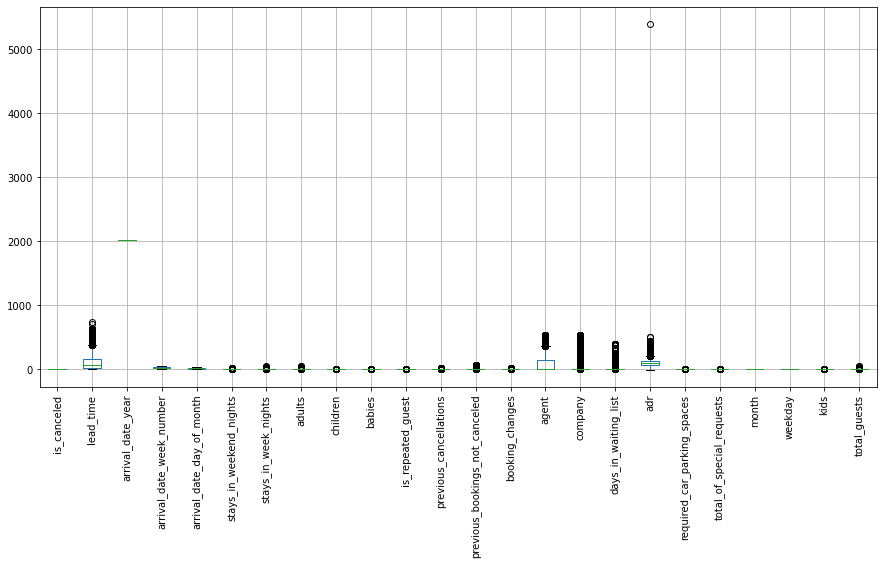

In [15]:
ax = df.boxplot(figsize=[15,7], rot = 90)
plt.show()

Data distribution - a literally closer look

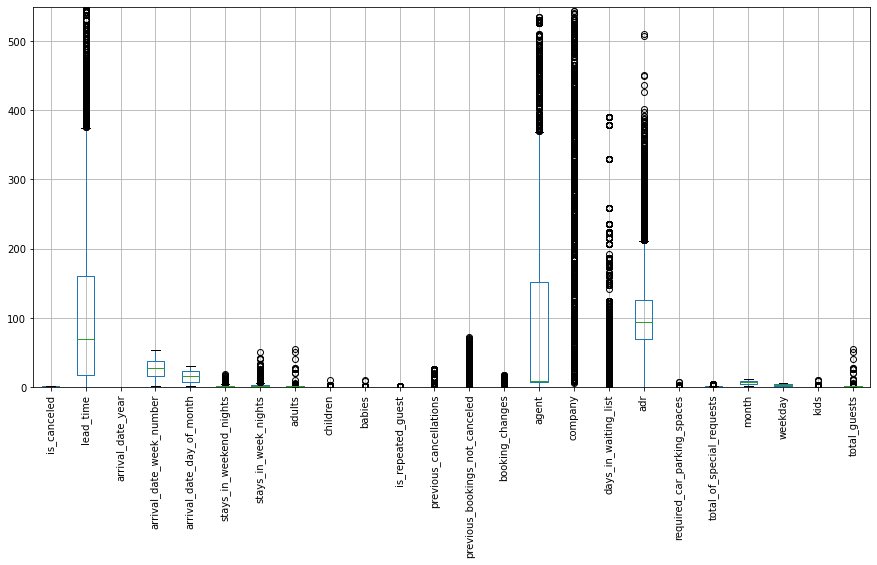

In [16]:
ax = df.boxplot(figsize=[15,7], rot = 90)
ax.set_ylim([0, 550])
plt.show()

Data visualization for the city hotel

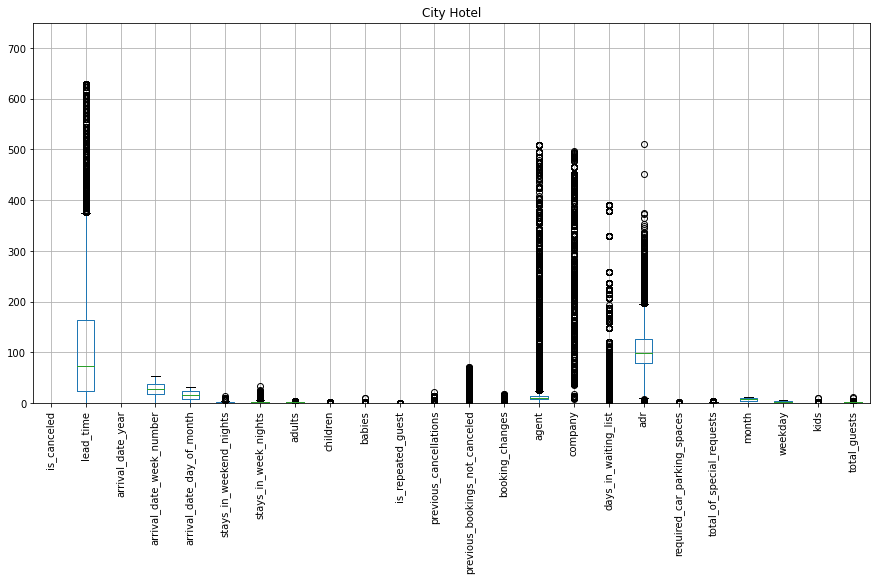

In [17]:
ax = df[df.hotel == 'City Hotel'].boxplot(figsize=[15,7], rot = 90)
ax.set_title('City Hotel')
ax.set_ylim([0, 750])
plt.show() 

The outlier with a room price of 5400 was found in a city hotel

Data visualization for the resort hotel

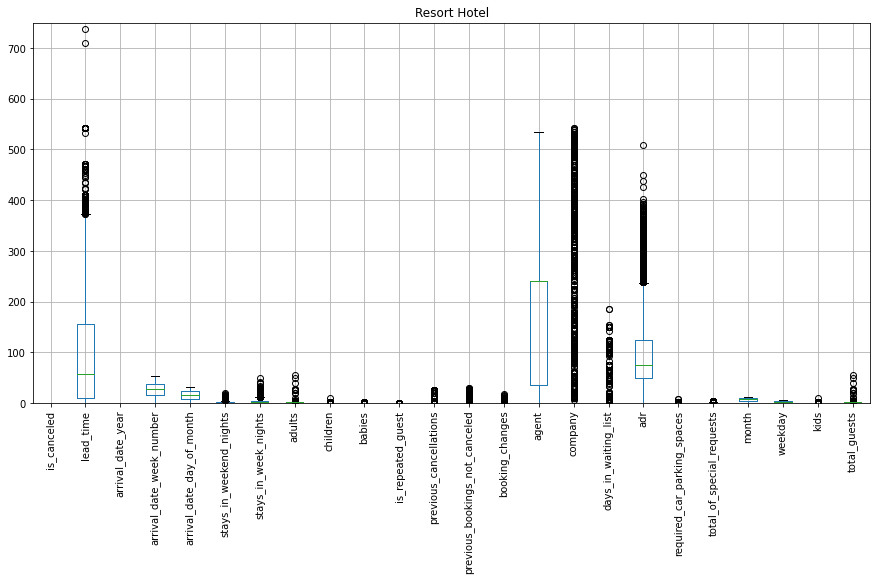

In [16]:
ax = df[df.hotel == 'Resort Hotel'].boxplot(figsize=[15,7], rot = 90)
ax.set_title('Resort Hotel')
ax.set_ylim([0, 750])
plt.show()

Travel agents were more often involved in resort hotel bookings.

Room prices were higher in the city hotel.

How balanced is the data: hotel types and cancellation rates

In [17]:
cty_hotel = df[df['hotel'] == 'City Hotel'].groupby('is_canceled')['hotel'].count()
res_hotel = df[df['hotel'] == 'Resort Hotel'].groupby('is_canceled')['hotel'].count()

cty_data = pd.DataFrame({"Hotel": "City Hotel",
                        "Cancellation": list(cty_hotel.index),
                        "Booking Records": list(cty_hotel.values)})
res_data = pd.DataFrame({"Hotel": "Resort Hotel",
                        "Cancellation": list(res_hotel.index),
                        "Booking Records": list(res_hotel.values)})

df_hotels = pd.concat([cty_data, res_data])
df_hotels['Cancellation'] = df_hotels.Cancellation.map({0: 'Travel', 1: 'Cancelled'})
df_hotels

,Hotel,Cancellation,Booking Records
0,City Hotel,Travel,46084
1,City Hotel,Cancelled,33079
0,Resort Hotel,Travel,28927
1,Resort Hotel,Cancelled,11120


### PLOT: Hotel types and cancellation rates

In [1]:
px.defaults.width = 1000
px.defaults.height = 800

fig1 = px.bar(df_hotels, x='Hotel', y='Booking Records', text = 'Booking Records',
             hover_data=['Hotel', 'Booking Records'], color='Cancellation', barmode='group',
            #  labels={'Values': 'Bookings'},
             color_discrete_map={
                'Travel': "deepskyblue",
                'Cancelled': "slategrey"})

fig1.update_layout(font_family="Tw Cen MT", 
                  font_size = 30,
                  margin={"r":0,"t":0,"l":0,"b":50},
                  template = 'plotly_white',
                  legend=dict(title_text='Cancellations by Hotel Type',
                  xanchor="center",
                  x=0.45,
                  orientation = 'h',
                  yanchor="bottom"))#,
                  # y=-0.15))
                  
fig1.update_traces(texttemplate='%{text: 1}', width = .25) #, textposition='outside')

fig1.update_xaxes(title_text = None)
fig1.update_yaxes(title_font_size=40, title_standoff=50)

fig1.show()

NameError: ignored

Save the plot

In [ ]:
# fig1.write_html("./Presentation/Booking_Rates.html")

----------------------------------------------------
## PLEASE FIND MOST OF THE BASIC EXPLORATION AT THE END OF THIS FILE!
----------------------------------------------------

Portugal is a popular destination: Guests come from 178 different countries!

In [ ]:
pd.Series(df.country.unique()).count()

### Counting and clustering the bookings by country and hotel type

First create the dataframe for city hotel bookings by country

In [ ]:
country_wise_cty_bookings = df.loc[(df['is_canceled'] == 0) & (df['hotel'] == 'City Hotel')]['country'].value_counts().reset_index()
country_wise_cty_bookings['hotel'] = 'City Hotel'
country_wise_cty_bookings.columns = ['Country', 'No of Bookings', 'Hotel']

Now create the dataframe for resort hotel bookings by country

In [ ]:
country_wise_res_bookings = df.loc[(df['is_canceled'] == 0) & (df['hotel'] == 'Resort Hotel')]['country'].value_counts().reset_index()
country_wise_res_bookings['hotel'] = 'Resort Hotel'
country_wise_res_bookings.columns = ['Country', 'No of Bookings', 'Hotel']

Second pool all countries with number of bookings < 500

City hotels

In [ ]:
main_country_wise_cty_bookings = country_wise_cty_bookings[country_wise_cty_bookings['No of Bookings'] >= 500]

other_country_wise_cty_bookings = {'Country':'OTHERS', 'No of Bookings':country_wise_cty_bookings[country_wise_cty_bookings['No of Bookings'] < 500]
                                ['No of Bookings'].sum(), 'Hotel':'City Hotel'}
#append row to the dataframe
main_country_cty_wise_bookings = main_country_wise_cty_bookings.append(other_country_wise_cty_bookings, ignore_index=True)

Resort hotels

In [ ]:
main_country_wise_res_bookings = country_wise_res_bookings[country_wise_res_bookings['No of Bookings'] >= 500]

other_country_wise_res_bookings = {'Country':'OTHERS', 'No of Bookings':country_wise_res_bookings[country_wise_res_bookings['No of Bookings'] < 500]
                                ['No of Bookings'].sum(), 'Hotel':'Resort Hotel'}
# Append row to the dataframe
main_country_res_wise_bookings = main_country_wise_res_bookings.append(other_country_wise_res_bookings, ignore_index=True)

main_country_cty_wise_bookings

### PLOT: Counting and clustering the city hotel bookings by country

In [ ]:
px.defaults.width = 800
px.defaults.height = 800

fig2 = px.pie(main_country_cty_wise_bookings, values='No of Bookings', names='Country', 
            #  title='City Hotel', 
             color='Country', 
             color_discrete_map={
                'PRT': 'red',
                'FRA': 'aliceblue',
                'DEU': 'yellow',
                'GBR': 'mediumblue',
                'ESP': 'skyblue',
                'ITA': 'whitesmoke',
                'BEL': 'lightgray',
                'NLD': 'salmon',
                'USA': 'firebrick',
                'BRA': 'gold',
                'CHE': 'violet',
                'AUT': 'white',
                'IRL': 'green',
                'SWE': 'cornflowerblue',
                'OTHERS': 'aqua'})

fig2.update_traces(textposition='inside', textinfo='percent+label+value')

fig2.update_layout(font_family="Tw Cen MT", 
                  font_size = 30,
                  margin={"r":0,"t":100,"l":0,"b":0},
                  template = 'plotly_white',
                  title={'text': 'Bookings City Hotel',
                         'y':0.97,
                         'x':0.5,
                         'xanchor': 'center',
                         'yanchor': 'top',
                         'font_size': 50},
                  showlegend = False)

fig2.show()

Save the plot

In [ ]:
fig2.write_html("./Presentation/Country_Booking_City.html")

### PLOT: Counting and clustering the resort hotel bookings by country

In [ ]:
px.defaults.width = 800
px.defaults.height = 800

fig3 = px.pie(main_country_res_wise_bookings, values='No of Bookings', names='Country', 
             color='Country', 
             color_discrete_map={
                'PRT': 'red',
                'FRA': 'aliceblue',
                'DEU': 'yellow',
                'GBR': 'mediumblue',
                'ESP': 'skyblue',
                'IRL': 'green',
                'CN': 'purple',
                'OTHERS': 'aqua'})

fig3.update_traces(textposition='inside', textinfo='percent+label+value')

fig3.update_layout(font_family="Tw Cen MT", 
                  font_size = 30,
                  margin={"r":0,"t":100,"l":0,"b":0},
                  template = 'plotly_white',
                  title={'text': 'Bookings Resort Hotel',
                         'y':0.97,
                         'x':0.5,
                         'xanchor': 'center',
                         'yanchor': 'top',
                         'font_size': 50},
                  showlegend = False)

fig3.show()

Save the plot

In [ ]:
# fig3.write_html("./Presentation/Country_Booking_Resort.html")

### Counting and clustering the cancellations by country and hotel type

First create the dataframe for city hotel cancellations by country

In [ ]:
country_wise_cty_cancellations = df.loc[(df['is_canceled'] == 1) & (df['hotel'] == 'City Hotel')]['country'].value_counts().reset_index()
country_wise_cty_cancellations['hotel'] = 'City Hotel'
country_wise_cty_cancellations.columns = ['Country', 'No of Cancellations', 'Hotel']

Now create the dataframe for resort hotel guests by country

In [ ]:
country_wise_res_cancellations = df.loc[(df['is_canceled'] == 1) & (df['hotel'] == 'Resort Hotel')]['country'].value_counts().reset_index()
country_wise_res_cancellations['hotel'] = 'Resort Hotel'
country_wise_res_cancellations.columns = ['Country', 'No of Cancellations', 'Hotel']

Second pool all countries with number of cancellations < 500

City hotels

In [ ]:
main_country_wise_cty_cancellations = country_wise_cty_cancellations[country_wise_cty_cancellations['No of Cancellations'] >= 500]

other_country_wise_cty_cancellations = {'Country':'OTHERS', 'No of Cancellations':country_wise_cty_cancellations[country_wise_cty_cancellations
                                       ['No of Cancellations'] < 500]['No of Cancellations'].sum(), 'Hotel':'City Hotel'}

#append row to the dataframe
main_country_cty_wise_cancellations = main_country_wise_cty_cancellations.append(other_country_wise_cty_cancellations, ignore_index=True)

Resort hotels

In [ ]:
main_country_wise_res_cancellations = country_wise_res_cancellations[country_wise_res_cancellations['No of Cancellations'] >= 500]

other_country_wise_res_cancellations = {'Country':'OTHERS', 'No of Cancellations':country_wise_res_cancellations[country_wise_res_cancellations
                                       ['No of Cancellations'] < 500]['No of Cancellations'].sum(), 'Hotel':'Resort Hotel'}

# Append row to the dataframe
main_country_res_wise_cancellations = main_country_wise_res_cancellations.append(other_country_wise_res_cancellations, ignore_index=True)

main_country_cty_wise_cancellations

### PLOT: Counting and clustering the city hotel bookings by country

In [ ]:
px.defaults.width = 800
px.defaults.height = 800

fig4 = px.pie(main_country_cty_wise_cancellations, values='No of Cancellations', names='Country', 
             color='Country', 
             color_discrete_map={
                'PRT': 'red',
                'FRA': 'aliceblue',
                'DEU': 'yellow',
                'GBR': 'mediumblue',
                'ESP': 'skyblue',
                'ITA': 'whitesmoke',
                'BRA': 'gold',
                'OTHERS': 'aqua'})

fig4.update_traces(textposition='inside', textinfo='percent+label+value')

fig4.update_layout(font_family="Tw Cen MT", 
                  font_size = 30,
                  margin={"r":0,"t":100,"l":0,"b":0},
                  template = 'plotly_white',
                  title={'text': 'Cancellations City Hotel',
                         'y':0.97,
                         'x':0.5,
                         'xanchor': 'center',
                         'yanchor': 'top',
                         'font_size': 50},
                  showlegend = False)

fig4.show()

Save the plot

In [ ]:
# fig4.write_html("./Presentation/Country_Cancellation_City.html")

### PLOT: Counting and clustering the city hotel cancellations by country

In [ ]:
px.defaults.width = 800
px.defaults.height = 800

fig5 = px.pie(main_country_res_wise_cancellations, values='No of Cancellations', names='Country', 
             color='Country', 
             color_discrete_map={
                'PRT': 'red',
                'GBR': 'mediumblue',
                'ESP': 'skyblue',
                'OTHERS': 'aqua'})

fig5.update_traces(textposition='inside', textinfo='percent+label+value')

fig5.update_layout(font_family="Tw Cen MT", 
                  font_size = 30,
                  margin={"r":0,"t":100,"l":0,"b":0},
                  template = 'plotly_white',
                  title={'text': 'Cancellations Resort Hotel',
                         'y':0.97,
                         'x':0.5,
                         'xanchor': 'center',
                         'yanchor': 'top',
                         'font_size': 50},
                  showlegend = False)

fig5.show()

Save the plot

In [ ]:
# fig5.write_html("./Presentation/Country_Cancellation_Resort.html")

### How many bookings are canceled? - Per month and by hotel type.

Create two dataframes, one for the city and one for the resort hotel

In [ ]:
cty_book_per_month = df.loc[(df["hotel"] == "City Hotel")].groupby("arrival_date_month")["hotel"].count()
cty_cancel_per_month = df.loc[(df["hotel"] == "City Hotel")].groupby("arrival_date_month")["is_canceled"].sum()

res_book_per_month = df.loc[(df["hotel"] == "Resort Hotel")].groupby("arrival_date_month")["hotel"].count()
res_cancel_per_month = df.loc[(df["hotel"] == "Resort Hotel")].groupby("arrival_date_month")["is_canceled"].sum()

cty_cancel_data = pd.DataFrame({"Hotel": "City Hotel",
                                "Month": list(cty_book_per_month.index),
                                "Bookings": list(cty_book_per_month.values),
                                "Cancelations": list(cty_cancel_per_month.values)})
res_cancel_data = pd.DataFrame({"Hotel": "Resort Hotel",
                                "Month": list(res_book_per_month.index),
                                "Bookings": list(res_book_per_month.values),
                                "Cancelations": list(res_cancel_per_month.values)})

Sort the months in dataframes using mapping

In [ ]:
cty_cancel_data["Month2"] = cty_cancel_data["Month"].map({"January": 1, "February": 2, "March": 3, "April": 4, "May": 5, 
                            "June": 6, "July": 7, "August": 8, "September": 9, "October": 10, "November": 11, "December": 12})
cty_cancel_data = cty_cancel_data.sort_values(by = 'Month2')
cty_cancel_data = cty_cancel_data.drop('Month2', axis = 1)
cty_cancel_data.reset_index(drop = True, inplace = True)

res_cancel_data["Month2"] = res_cancel_data["Month"].map({"January": 1, "February": 2, "March": 3, "April": 4, "May": 5, 
                            "June": 6, "July": 7, "August": 8, "September": 9, "October": 10, "November": 11, "December": 12})
res_cancel_data = res_cancel_data.sort_values(by = 'Month2')
res_cancel_data = res_cancel_data.drop('Month2', axis = 1)
res_cancel_data.reset_index(drop = True, inplace = True)

# Concatination of city and resort hotel dataframes
full_cancel_data = pd.concat([cty_cancel_data, res_cancel_data], ignore_index=True)
full_cancel_data["cancel_percent"] = full_cancel_data["Cancelations"] / full_cancel_data["Bookings"] * 100

full_cancel_data.head()

### PLOT: How many bookings are canceled? - Per month and by hotel type.

In [ ]:
px.defaults.width = 1200
px.defaults.height = 800

fig6 = px.bar(full_cancel_data, x='Month', y='cancel_percent', text = 'cancel_percent',
             hover_data=['Hotel', 'cancel_percent'], color='Hotel', barmode='group',
             labels={'cancel_percent':'Cancellations in %'},
             color_discrete_map={
                "City Hotel": "crimson",
                "Resort Hotel": "slategrey"})

fig6.update_layout(font_family="Tw Cen MT", 
                  font_size = 30,
                  margin={"r":0,"t":0,"l":0,"b":50},
                  template = 'plotly_white',
                  legend=dict(title_text='Cancellations by Hotel Type',
                  xanchor="center",
                  x=0.45,
                  orientation = 'h',
                  yanchor="bottom",
                  y=-.28))

fig6.update_traces(texttemplate='%{text: .4s}') #, textposition='outside')

fig6.update_xaxes(title_text = None,
                 tickangle=-45)
fig6.update_yaxes(title_font_size=40, title_standoff=50)

#fig6.update_xaxes(rangeslider_visible=True)
fig6.show()

Save the plot

In [ ]:
# fig6.write_html("./Presentation/Cancel_Rates.html")

### How many kids (children + babies) are going on vacation compared to adults without kids? - Per month and by hotel type

Create the dataframe for the kids for the city and the resort hotel

In [ ]:
kids_cty_no_cancel_per_month = df.loc[(df["hotel"] == "City Hotel") & (df['kids'] > 0) & (df["is_canceled"] == 0)].groupby("arrival_date_month")["kids"].sum()
kids_cty_cancel_per_month = df.loc[(df["hotel"] == "City Hotel") & (df['kids'] > 0) & (df["is_canceled"] == 1)].groupby("arrival_date_month")["kids"].sum()

kids_res_no_cancel_per_month = df.loc[(df["hotel"] == "Resort Hotel") & (df['kids'] > 0) & (df["is_canceled"] == 0)].groupby("arrival_date_month")["kids"].sum()
kids_res_cancel_per_month = df.loc[(df["hotel"] == "Resort Hotel") & (df['kids'] > 0) & (df["is_canceled"] == 1)].groupby("arrival_date_month")["kids"].sum()

kids_cty_cancel_data = pd.DataFrame({"Hotel": "City Hotel",
                                "Month": list(kids_cty_cancel_per_month.index),                                
                                "Vacations": list(kids_cty_no_cancel_per_month.values),
                                "Cancelations": list(kids_cty_cancel_per_month.values)})
kids_res_cancel_data = pd.DataFrame({"Hotel": "Resort Hotel",
                                "Month": list(kids_res_cancel_per_month.index),
                                "Vacations": list(kids_res_no_cancel_per_month.values),
                                "Cancelations": list(kids_res_cancel_per_month.values)})

Sort the months in dataframes using mapping

In [ ]:
kids_cty_cancel_data["Month2"] = kids_cty_cancel_data["Month"].map({"January": 1, "February": 2, "March": 3, "April": 4, "May": 5, 
                            "June": 6, "July": 7, "August": 8, "September": 9, "October": 10, "November": 11, "December": 12})
kids_cty_cancel_data = kids_cty_cancel_data.sort_values(by = 'Month2')
kids_cty_cancel_data = kids_cty_cancel_data.drop('Month2', axis = 1)
kids_cty_cancel_data.reset_index(drop = True, inplace = True)

kids_res_cancel_data["Month2"] = kids_res_cancel_data["Month"].map({"January": 1, "February": 2, "March": 3, "April": 4, "May": 5, 
                            "June": 6, "July": 7, "August": 8, "September": 9, "October": 10, "November": 11, "December": 12})
kids_res_cancel_data = kids_res_cancel_data.sort_values(by = 'Month2')
kids_res_cancel_data = kids_res_cancel_data.drop('Month2', axis = 1)
kids_res_cancel_data.reset_index(drop = True, inplace = True)

Concatination of the dataframes for kids

In [ ]:
kids_full_cancel_data = pd.concat([kids_cty_cancel_data, kids_res_cancel_data], ignore_index=True)

Adding 2 columns with percent values: cancellations and non-cancelled travels

In [ ]:
kids_full_cancel_data["Cancel Percent"] = kids_full_cancel_data['Cancelations'] / (kids_full_cancel_data['Cancelations'] 
                                             + kids_full_cancel_data['Vacations']) * 100
kids_full_cancel_data["Travels in Percent"] = 100 - kids_full_cancel_data['Cancel Percent'] 

Adding a columns for data identification as kids' data

In [ ]:
kids_full_cancel_data["Person"] = 'Children'

Adding a columns for data identification as kids' hotel type data

In [ ]:
kids_full_cancel_data["Hotel"] = kids_full_cancel_data["Hotel"].map({"City Hotel": "Children City Hotel", "Resort Hotel": "Children Resort Hotel"})

Creating the dataframe for adults without kids for the city and the resort hotel

In [ ]:
adults_cty_no_cancel_per_month = df.loc[(df["hotel"] == "City Hotel") & (df['kids'] == 0) & (df["is_canceled"] == 0)].groupby("arrival_date_month")["adults"].sum()
adults_cty_cancel_per_month = df.loc[(df["hotel"] == "City Hotel") & (df['kids'] == 0) & (df["is_canceled"] == 1)].groupby("arrival_date_month")["adults"].sum()

adults_res_no_cancel_per_month = df.loc[(df["hotel"] == "Resort Hotel") & (df['kids'] == 0) & (df["is_canceled"] == 0)].groupby("arrival_date_month")["adults"].sum()
adults_res_cancel_per_month = df.loc[(df["hotel"] == "Resort Hotel") & (df['kids'] == 0) & (df["is_canceled"] == 1)].groupby("arrival_date_month")["adults"].sum()

adults_cty_cancel_data = pd.DataFrame({"Hotel": "City Hotel",
                                "Month": list(adults_cty_cancel_per_month.index),                                
                                "Vacations": list(adults_cty_no_cancel_per_month.values),
                                "Cancelations": list(adults_cty_cancel_per_month.values)})
adults_res_cancel_data = pd.DataFrame({"Hotel": "Resort Hotel",
                                "Month": list(adults_res_cancel_per_month.index),
                                "Vacations": list(adults_res_no_cancel_per_month.values),
                                "Cancelations": list(adults_res_cancel_per_month.values)})

Sort the months in dataframes using mapping

In [ ]:
adults_cty_cancel_data["Month2"] = adults_cty_cancel_data["Month"].map({"January": 1, "February": 2, "March": 3, "April": 4, "May": 5, 
                            "June": 6, "July": 7, "August": 8, "September": 9, "October": 10, "November": 11, "December": 12})
adults_cty_cancel_data = adults_cty_cancel_data.sort_values(by = 'Month2')
adults_cty_cancel_data = adults_cty_cancel_data.drop('Month2', axis = 1)
adults_cty_cancel_data.reset_index(drop = True, inplace = True)

adults_res_cancel_data["Month2"] = adults_res_cancel_data["Month"].map({"January": 1, "February": 2, "March": 3, "April": 4, "May": 5, 
                            "June": 6, "July": 7, "August": 8, "September": 9, "October": 10, "November": 11, "December": 12})
adults_res_cancel_data = adults_res_cancel_data.sort_values(by = 'Month2')
adults_res_cancel_data = adults_res_cancel_data.drop('Month2', axis = 1)
adults_res_cancel_data.reset_index(drop = True, inplace = True)

Concatination of the dataframes for adults without kids

In [ ]:
adults_full_cancel_data = pd.concat([adults_cty_cancel_data, adults_res_cancel_data], ignore_index=True)

Adding 2 columns with percent values: cancellations and non-cancelled travels

In [ ]:
adults_full_cancel_data["Cancel Percent"] = adults_full_cancel_data['Cancelations'] / (adults_full_cancel_data['Cancelations'] 
                                          + adults_full_cancel_data['Vacations']) * 100
adults_full_cancel_data["Travels in Percent"] = 100 - adults_full_cancel_data['Cancel Percent']

Adding a columns for data identification as adults' data

In [ ]:
adults_full_cancel_data["Person"] = 'Adults'

Adding a columns for data identification as adults' hotel type data

In [ ]:
adults_full_cancel_data["Hotel"] = adults_full_cancel_data["Hotel"].map({"City Hotel": "Adults City Hotel", "Resort Hotel": "Adults Resort Hotel"})

kidsadults_full_cancel_data = pd.concat([kids_full_cancel_data, adults_full_cancel_data], axis = 0)

kidsadults_full_cancel_data.head()

### PLOT: How many kids (children + babies) are going on vacation compared to adults without kids? - Per month and by hotel type

In [ ]:
px.defaults.width = 1700
px.defaults.height = 800

fig7 = px.bar(kidsadults_full_cancel_data, x='Month', y='Travels in Percent', text = 'Travels in Percent',
             hover_data=['Hotel', 'Cancel Percent'], color='Hotel', barmode='group', facet_col = 'Person', facet_col_spacing = .05,
            labels={'Travels in Percent':'Travels in %'},
             color_discrete_map={
                "Children City Hotel": "deeppink",
                "Children Resort Hotel": "deepskyblue",
                "Adults City Hotel": "red",
                "Adults Resort Hotel": "darkblue"})

fig7.update_layout(font_family="Tw Cen MT", 
                  font_size = 30,
                  margin={"r":0,"t":0,"l":0,"b":50},
                  template = 'plotly_white',
                  legend=dict(title_text='Travels by Hotel Type and Guest',
                  xanchor="center",
                  x=0.45,
                  orientation = 'h',
                  yanchor="bottom",
                  y=-.28))

fig7.update_traces(texttemplate='%{text: .4s}', width = .4) #, textposition='outside')

fig7.update_xaxes(title_text = None,
                 tickangle=-45)
fig7.update_yaxes(title_font_size=40, title_standoff=50)

fig7.show()

It is obvious, that most travels are cancelled for / in June - at the start of summer holidays in Portugal.

**51.6 % OF ALL TRAVELS WITH CHILDREN TO THE RESORT HOTEL ARE CANCELLED IN JUNE! **

Save the plot

In [ ]:
# fig7.write_html("./Presentation/Travel_Rates_Adults_Kids.html")

**BUT: Cancellation rates from children's data perspective - total numbers tell a slightly different story**

In [ ]:
df[['is_canceled', 'arrival_date_month', 'adults', 'children', 'babies']].groupby('arrival_date_month').sum()

### How many different travel constellations does the dataset contain? E. g. parents with 2 children, couples, singles, travel groups.

In [ ]:
df_guests = df[['hotel', 'is_canceled', 'adults', 'children', 'babies']].groupby(['is_canceled', 'adults','children', 'babies']).count()
df_guests = df_guests.reset_index()
df_guests.columns = ['Trip', 'Adults', 'Children', 'Babies', 'Sum Travel Group']

df_guests['Trip'] = df_guests['Trip'].map({0: 'Travel', 1: 'Cancellation'})
df_guests['Kids'] = df_guests.Children + df_guests.Babies

df_guests

### PLOT: How many travels in different constellations do take place or are called off? E. g. parents with 2 children, couples, singles, travel groups.

In [ ]:
px.defaults.color_continuous_scale = px.colors.sequential.Plasma
px.defaults.width = 1200
px.defaults.height = 800
fig8 = px.scatter(df_guests, x="Adults", y="Kids",
	            size='Sum Travel Group', color="Trip",
                hover_name="Trip", log_x=True, size_max=300, template = 'plotly_white',
                color_discrete_map={
                "Travel": "yellow",
                "Cancellation": "darkblue"})

fig8.update_layout(font_family="Tw Cen MT", 
                  font_size = 30,
                  margin={"r":0,"t":0,"l":0,"b":50},
                  template = 'plotly_white',
                  legend=dict(title_text='Trips',
                  xanchor="center",
                  x=0.45,
                  orientation = 'h',
                  yanchor="bottom",
                  y=-.28))

fig8.update_yaxes(title_font_size=40, title_standoff=50)

fig8.show()

**Even though many family trips are canceled in June, still most travels of families with children take place (yellow dots) compared to the cancellations.**

Save the plot

In [ ]:
# fig8.write_html("./Presentation/Families.html")

### PLOT: Travels and cancellations by market segment and travel group size

In [ ]:
px.defaults.color_continuous_scale = px.colors.sequential.Plasma
px.defaults.width = 1200
px.defaults.height = 800
fig9 = px.scatter(df, x="market_segment", y="adr",
	            size='total_guests', color="is_canceled",
                template = 'plotly_white', range_y=[0, 600], size_max=30,
                # log_x=True, hover_name="Trip",  
                color_discrete_map={
                "Travel": "yellow",
                "Cancellation": "darkblue"})

fig9.update_layout(font_family="Tw Cen MT", 
                  font_size = 30,
                  margin={"r":0,"t":0,"l":0,"b":50},
                  template = 'plotly_white',
                  legend=dict(title_text='Trips',
                  xanchor="center",
                  x=0.45,
                  orientation = 'h',
                  yanchor="bottom",
                  y=-.28))

fig9.update(layout_coloraxis_showscale=False)
fig9.update_xaxes(title_text = None,
                 tickangle=-45)
fig9.update_yaxes(title_font_size=40, title_standoff=50)

fig9.show()

Save the plot

In [ ]:
# fig9.write_html("./Presentation/ADR_Market_Segment.html")

### What are the room prices for travels and cancelled bookings for adults who travel without kids (children and / or babies)?

In [ ]:
adr_adults = df[(df['adults'] > 0) & (df['kids'] == 0) & (df['adr'] > 0)]
adr_adults

PLOT: What are the room prices for travels and cancelled bookings for adults who travel without kids (children and / or babies)?

In [ ]:
px.defaults.color_continuous_scale = px.colors.sequential.Plasma
px.defaults.width = 600
px.defaults.height = 800
fig10 = px.scatter(adr_adults, x="adults", y="adr", 
	            size='total_guests', color="is_canceled",
                template = 'plotly_white', range_y=[0, 600], #size_max=30,
                # hover_name="Trip", log_x=True, 
                color_discrete_map={
                "Travel": "yellow",
                "Cancellation": "darkblue"})

fig10.update_layout(font_family="Tw Cen MT", 
                  font_size = 30,
                  margin={"r":0,"t":80,"l":0,"b":0},
                  template = 'plotly_white',
                  title={'text': 'ADR Adults Only',
                         'y':0.97,
                         'x':0.5,
                         'xanchor': 'center',
                         'yanchor': 'top',
                         'font_size': 50},
                  legend=dict(title_text='Trips',
                  xanchor="center",
                  x=0.45,
                  orientation = 'h',
                  yanchor="bottom",
                  y=-.28))

fig10.update(layout_coloraxis_showscale=False)
fig10.update_xaxes(title_text = None)
fig10.update_yaxes(title_font_size=40, title_standoff=50)

fig10.show()

Save the plot

In [ ]:
# fig10.write_html("./Presentation/ADR_Adults.html")

### What are the room prices for travels and cancelled bookings for families (adults with children and / or babies)?

In [ ]:
adr_families = df[(df['adults'] > 0) & (df['kids'] > 0) & (df['adr'] > 0)]
adr_families

### PLOT: What are the room prices for travels and cancelled bookings for families (adults with children and / or babies)?

In [ ]:
px.defaults.color_continuous_scale = px.colors.sequential.Plasma
px.defaults.width = 600
px.defaults.height = 800
fig11 = px.scatter(adr_families, x="adults", y="adr", 
	            size='total_guests', color="is_canceled",
                template = 'plotly_white', range_y=[0, 600], 
                color_discrete_map={
                "Travel": "yellow",
                "Cancellation": "darkblue"})

fig11.update_layout(font_family="Tw Cen MT", 
                  font_size = 30,
                  margin={"r":0,"t":80,"l":0,"b":00},
                  template = 'plotly_white',
                  title={'text': 'ADR Families',
                         'y':0.97,
                         'x':0.5,
                         'xanchor': 'center',
                         'yanchor': 'top',
                         'font_size': 50},
                  legend=dict(title_text='Trips',
                  xanchor="center",
                  x=0.45,
                  orientation = 'h',
                  yanchor="bottom",
                  y=-.28))
                  
fig11.update(layout_coloraxis_showscale=False)
fig11.update_xaxes(title_text = None)
fig11.update_yaxes(title_font_size=40, title_standoff=50)

fig11.show()

Insights:
*   Adults without children pay slightly higher room prices than families.
*   THERE ARE ONLY 3 BOOKINGS (of which 1 was canceled) OF FAMILIES WITH AT LEAST 1 CHILD
WHILE THERE ARE MANY MORE WITH 4 ADULTS ONLY.

Save the plot

In [ ]:
# fig11.write_html("./Presentation/ADR_Families.html")

### Travel and cancellation bookings by deposit types 

In [ ]:
deposit_travel = df[df['is_canceled'] == 0].groupby(['deposit_type', 'hotel'])["is_canceled"].count().reset_index()
deposit_travel.columns = ['Deposit Type', 'Hotel', 'Bookings']
deposit_travel['Trip'] = 'Travel'

deposit_cancel = df[df['is_canceled'] == 1].groupby(['deposit_type', 'hotel'])["is_canceled"].count().reset_index()
deposit_cancel.columns = ['Deposit Type', 'Hotel', 'Cancellations']
deposit_cancel['Trip'] = 'Canceled'

deposit_cancel

### PLOT: Travels by deposit types 

In [ ]:
px.defaults.width = 700
px.defaults.height = 800

fig12 = px.bar(deposit_travel, x='Deposit Type', y='Bookings', text = 'Bookings', 
             hover_data=['Deposit Type', 'Hotel', 'Bookings', 'Trip'], color='Deposit Type', barmode='group', facet_col = 'Hotel', facet_col_spacing = .17,
             color_discrete_map={
                'No Deposit': 'deepskyblue',
                'Non Refund': 'red',
                'Refundable': 'darkblue'})

fig12.update_layout(font_family="Tw Cen MT", 
                  font_size = 30,
                  margin={"r":0,"t":100,"l":0,"b":0},
                  template = 'plotly_white',
                  title={'text': 'Travels',
                         'y':0.995,
                         'x':0.5,
                         'xanchor': 'center',
                         'yanchor': 'top',
                         'font_size': 50},
                  showlegend = False)

fig12.update_traces(width = .6) #, texttemplate='%{text: 1}', textposition='outside')

fig12.update_xaxes(title_text = None,
                 tickangle=-45)
fig12.update_yaxes(title_font_size=40, title_standoff=50, range=[0, 46000])

fig12.show()

Save the plot

In [ ]:
# fig12.write_html("./Presentation/Deposit_Travel.html")

### PLOT: Cancellations by deposit types

In [ ]:
px.defaults.width = 700
px.defaults.height = 800

fig13 = px.bar(deposit_cancel, x='Deposit Type', y='Cancellations', text = 'Cancellations', 
             hover_data=['Deposit Type', 'Hotel', 'Cancellations', 'Trip'], color='Deposit Type', barmode='group', facet_col = 'Hotel', facet_col_spacing = .17,
             color_discrete_map={
                'No Deposit': 'deepskyblue',
                'Non Refund': 'red',
                'Refundable': 'darkblue'})

fig13.update_layout(font_family="Tw Cen MT", 
                  font_size = 30,
                  margin={"r":0,"t":100,"l":0,"b":0},
                  template = 'plotly_white',
                  title={'text': 'Cancellations',
                         'y':0.995,
                         'x':0.5,
                         'xanchor': 'center',
                         'yanchor': 'top',
                         'font_size': 50},
                  showlegend = False)

fig13.update_traces(width = .6) #, texttemplate='%{text: 1}', textposition='outside')

fig13.update_xaxes(title_text = None,
                 tickangle=-45)
fig13.update_yaxes(title_font_size=40, title_standoff=50, range=[0, 46000])

fig13.show()

Insights: 
*   Obviously people didn't travel because they wanted to keep their deposit. 
*   On the contrary: Most people by far with a non-refundable deposit canceled their trips.

Save the plot

In [ ]:
# fig13.write_html("./Presentation/Deposit_Cancellation.html")

### A little price evaluation

Maximum price entry in the database

In [ ]:
df.adr.max()

Mean booking price by hotel type *including* the maximum outlier

In [ ]:
df.adr.groupby(df.hotel).mean()

Mean booking price by hotel type *excluding* the maximum outlier

In [ ]:
df[df.adr != df.adr.max()].adr.groupby(df.hotel).mean()

The outlier makes a difference of almost 7 ct. in the mean price of city hotels.

**Something is seriously wrong with the maximum price of 5400. **
2 adults in just 1 night...? 
The trip has been canceled anyway.

In [ ]:
df[df.adr == df.adr.max()]

### Distribution of room prices by hotel type

In [ ]:
df[df.adr != df.adr.max()].adr.groupby(df.hotel).hist(bins = 50, legend = True)

### What are the correct ADRs by deposit type and non/cancellation?

Eliminating bookings with ADR <= 0

In [ ]:
df_adr = df[df.adr > 0]

Removing the ADR outlier (5400 EUR) as seen above

In [ ]:
df_adr[df_adr.adr != df_adr.adr.max()]

Dataframe with basic information from df_adr

In [ ]:
deposit_price_data = df_adr[['is_canceled', 'total_guests', 'deposit_type', 'adr', 'stays_in_weekend_nights', 'stays_in_week_nights']].groupby(['deposit_type', 'is_canceled']).sum()

Counting the bookings by deposit type and cancellation status with adr > 0

In [ ]:
deposit_adr_bookings = df_adr[['is_canceled', 'total_guests', 'deposit_type', 'adr', 'stays_in_weekend_nights', 'stays_in_week_nights']].groupby(['deposit_type', 'is_canceled'])['adr'].count()

deposit_price_data.reset_index(inplace = True)

Addition of column 'total_nights'

In [ ]:
deposit_price_data['total_nights'] = deposit_price_data.stays_in_weekend_nights + deposit_price_data.stays_in_week_nights

Addition of number of bookings

In [ ]:
deposit_price_data['no_of_bookings'] = deposit_adr_bookings.values

Calculation of real ADR by deposit type and cancellation status

In [ ]:
deposit_price_data['mean_adr'] = deposit_price_data.adr / deposit_price_data.no_of_bookings

deposit_price_data

### How do the room prices (ADR) for city and resort hotels change by month?

Extracting the basic data for travels that have not been canceled and by hotel type

In [ ]:
data_resort = df[(df['hotel'] == 'Resort Hotel') & (df['is_canceled'] == 0)]
data_city = df[(df['hotel'] == 'City Hotel') & (df['is_canceled'] == 0)]

Collecting the city hotel data

In [ ]:
city_hotel=data_city.groupby(['arrival_date_month'])['adr'].mean().reset_index()
city_hotel['hotel'] = 'City Hotel'
city_hotel.columns = ['Month', 'ADR', 'Hotel']

Collecting the resort hotel data

In [ ]:
resort_hotel = data_resort.groupby(['arrival_date_month'])['adr'].mean().reset_index()
resort_hotel['hotel'] = 'Resort Hotel'
resort_hotel.columns = ['Month', 'ADR', 'Hotel']

Concatenating city and resort hotel

In [ ]:
final_hotel = pd.concat([city_hotel, resort_hotel])
final_hotel

Sorting the data by month using 'import sort_dataframeby_monthorweek as sd' in a function

In [ ]:
def sort_month(df, column_name):
    return sd.Sort_Dataframeby_Month(df, column_name)

final_prices = sort_month(final_hotel, 'Month')
final_prices

### PLOT: How do the room prices (ADR) for city and resort hotels change by month?

In [ ]:
px.defaults.width = 1200
px.defaults.height = 800

fig14 = px.line(final_prices, x='Month', y = 'ADR', color = 'Hotel', 
                color_discrete_map={
                "City Hotel": "red",
                "Resort Hotel": "darkblue"})

fig14.update_layout(font_family="Tw Cen MT", 
                  font_size = 30,
                  margin={"r":0,"t":0,"l":0,"b":50},
                  template = 'plotly_white',
                  legend=dict(title_text='Price Development Over The Year',
                  xanchor="center",
                  x=0.45,
                  orientation = 'h',
                  yanchor="bottom",
                  y=-.28))

fig14.update_xaxes(title_text = None,
                 tickangle=-45)
fig14.update_yaxes(title_font_size=40, title_standoff=50)

fig14.show()

Save the plot

In [ ]:
# fig14.write_html("./Presentation/ADR_Months.html")

-----------------------------------------------------
## THE BASIC & MARKETING-WISE EXPLORATION STARTS HERE!
-----------------------------------------------------

### Booking data by year

In [ ]:
df.arrival_date_year.hist(bins = 5)

In [ ]:
all_bookings = pd.DataFrame(df.is_canceled.groupby(df.hotel).count())
all_bookings.columns = ['all_bookings']
all_bookings

### Constellations of traveling mates who canceled their trips

Please take notice of the first line: 84 travels with 453 children, 3 babies and no adults were canceled?

In [ ]:
df[['is_canceled','adults', 'children', 'babies']].groupby('adults').sum()

### Not (0) / canceled (1) trips by the age of the travelers 

In [ ]:
df[['is_canceled','adults', 'children', 'babies']].groupby('is_canceled').sum().plot(kind = 'bar')

### Distribution of adults, children and babies in the dataset

In [ ]:
df[['adults', 'children', 'babies']].sum().plot(kind = 'bar')

### All adults not minding the cancellation status

In [ ]:
df[['adults', 'children', 'babies']].groupby('adults').sum().plot(kind = 'bar')

### How many bookings have not been canceled?

In [ ]:
df.is_canceled.count() - df.is_canceled.sum()

### Adults who canceled by number and company of children and babies

Read: Most cancellations came from 2 adults with/out children and babies.

In [ ]:
df[['is_canceled', 'adults', 'children', 'babies']].groupby('adults').sum()

### PLOT: Adults who canceled by number and company of children and babies

Read: Most cancellations came from 2 adults with/out children and babies.

In [ ]:
df[['is_canceled','adults', 'children', 'babies']].groupby('adults').sum().plot(kind = 'bar')

### Adults who did not cancel

In [ ]:
(df[['is_canceled','adults']].groupby('adults').count() - df[['is_canceled','adults']].groupby('adults').sum()).plot(kind = 'bar')

### Cancellation rates from children's data perspective

In [ ]:
df[['is_canceled', 'adults', 'children', 'babies']].groupby('children').sum()

### How many travels have not been canceled - by customer type?

In [ ]:
df[df['is_canceled'] == 0].groupby('customer_type')['is_canceled'].count()

### Number of bookings by market segment (not cancelled)

In [ ]:
df[df['is_canceled'] == 0].groupby('market_segment')['is_canceled'].count()

### Number of cancellations by market segment

In [ ]:
df[df['is_canceled'] == 1].groupby('market_segment')['is_canceled'].count()

### Number of cancellations by customer type

In [ ]:
df[df['is_canceled'] == 1].groupby('customer_type')['is_canceled'].count()

### 251 records for City Hotels are neither canceled, nor do they have overnight stays; the price (adr) == 0 

In [ ]:
df[(df.stays_in_weekend_nights + df.stays_in_week_nights ==0) & (df.is_canceled == 0) & (df.adr == 0) & (df.hotel == 'City Hotel')]

### 371 records for Resort Hotels are neither canceled, nor do they have overnight stays; the price (adr) == 0 

In [ ]:
df[(df.stays_in_weekend_nights + df.stays_in_week_nights ==0) & (df.is_canceled == 0) & (df.adr == 0) & (df.hotel == 'Resort Hotel')]

In [ ]:
df['not_canceled'] = df.is_canceled.map({0:1, 1:0}) 

### Guests' arrivals by month and hotel type

In [ ]:
df.arrival_date_month.groupby(df.hotel).hist(bins = 23, figsize = [7 , 5], xrot = 45)

### Guests' arrivals by weekday and hotel type

In [ ]:
df.weekday.groupby(df.hotel).hist(bins = 13, figsize = [7 , 5])

### Mean stay duration on weekends by hotel type

In [ ]:
df.stays_in_weekend_nights.groupby(df.hotel).mean()

### Number of stays on weekends by hotel type

In [ ]:
sns.countplot(x="stays_in_weekend_nights", data=df, hue = "hotel" ,palette = 'plasma', saturation = 1)

### How long have the guests been waiting between booking and day of arrival at their hotels? 

In [ ]:
df.lead_time.hist(bins = 50)

In [ ]:
sns.catplot(x="stays_in_weekend_nights", y = 'stays_in_week_nights', data=df, kind="boxen", height = 10)

### Cancellation and travel ("valid booking") rates in total and in % by hotel type

In [ ]:
cancellation = pd.DataFrame({'hotel': ['City Hotel', 'Resort Hotel'], 
                             'canceled_bookings': list(df.is_canceled.groupby(df.hotel).sum()), 
                             'valid_bookings': list(df.is_canceled.groupby(df.hotel).count() - df.is_canceled.groupby(df.hotel).sum()),
                             'all_bookings': list(df.is_canceled.groupby(df.hotel).count())})

cancellation['canceled_bookings_%'] = cancellation.canceled_bookings/cancellation.all_bookings*100
cancellation['valid_bookings_%'] = cancellation.valid_bookings/cancellation.all_bookings*100
cancellation = cancellation [['hotel', 'all_bookings', 'canceled_bookings', 'canceled_bookings_%', 'valid_bookings', 'valid_bookings_%']]
cancellation.set_index('hotel', inplace = True)
cancellation

### Cancellation and travel ("valid booking") rates in total by hotel type

In [ ]:
cancellation[['canceled_bookings','valid_bookings']].plot(kind = 'bar')

### Cancellation and travel ("valid booking") rates in % by hotel type

In [ ]:
cancellation[['canceled_bookings_%','valid_bookings_%']].plot(kind = 'bar')


**City hotel bookings are much more often canceled than those of the resort hotel.**

### How many travels - by hotel type - had an agent involved (not minding the cancellation rate)? 

In [ ]:
agent_val = pd.DataFrame(df[df.agent > 0].groupby(df.hotel).agent.count())
agent_nan = pd.DataFrame(df[df.agent == 0].groupby(df.hotel).agent.count())
agent = pd.concat([agent_val, agent_nan], axis = 1)
agent.columns = ['agent', 'no_agent']
agent = agent.reset_index()
agent['no_agent_percent'] = agent.no_agent/(agent.agent + agent.no_agent)*100

agent

### Comparison of all columns by city / resort hotel 

E. g.: 
- Cancellations are three times higher in the city hotel compared to the resort hotel while booking data is only twice the amount. 
- The price structures differ very much by hotel type.
- Overall there are few bookings with children and babies, and only few more in the resort hotel than in the city hotel.


In [ ]:
df_overview = df[['hotel', 'is_canceled', 'lead_time', 'arrival_date_year',
       'arrival_date_month', 'arrival_date_day_of_month', 'weekday', 'stays_in_weekend_nights',
       'stays_in_week_nights', 'adults', 'children', 'babies', 'meal',
       'country', 'market_segment', 'distribution_channel',
       'is_repeated_guest', 'previous_cancellations',
       'previous_bookings_not_canceled', 'reserved_room_type',
       'assigned_room_type', 'booking_changes', 'deposit_type', 'days_in_waiting_list', 'customer_type', 'adr',
       'required_car_parking_spaces', 'total_of_special_requests',
       'reservation_status']]

df_overview.groupby(df_overview.hotel).hist(figsize = [20, 20])

### Comparison of all columns by weekdays

In [ ]:
df_overview.groupby(df_overview.weekday).hist(figsize = [20, 20])